# A computational building block approach towards multiscale hierarchical architected materials analysis and design with application to hierarchical metal metamaterials    

### Markus J. Buehler
email: mbuehler@mit.edu  

Abstract: In this study we report a computational approach towards multiscale architected materials analysis and design. A particular challenge in modeling and simulation of materials, and especially the development of hierarchical design approaches, has been to identify ways by which complex multi-level material structures can be effectively modeled. One way to achieve this is to use coarse-graining approaches, where  physical relationships can be effectively described with reduced dimensionality. In this paper we report an integrated deep neural network architecture that first learns coarse-grained representations of complex hierarchical microstructure data via a discrete variational autoencoder and then utilizes an attention-based diffusion model solve both forward and inverse problems, including a capacity to solve degenerate design problems. As an application, we demonstrate the method in the analysis and design of hierarchical highly porous metamaterials within the context of nonlinear stress-strain responses to compressive deformation.  We validate the mechanical behavior and mechanisms of deformation using embedded-atom molecular dynamics simulations carried out for copper and nickel, showing good agreement with the design objectives.  

##### Reference: 

[1] M. Buehler, A computational building block approach towards multiscale architected materials analysis and design with application to hierarchical metal metamaterials , Modelling and Simulation in Materials Science and Engineering, 2023 

### This code consists of 3 models

This code consists of three models: Model 1 (VQ-VAE to encode hierarchical architected microstructures), Model 2 (diffusion model to predict hierarchical architected microstructures from a stress-strain response conditioning), and Model 3 (diffusion model to predict stress-strain response from a microstructure)

## Model 1: VQ-VAE model to learn codebook representations of hierarchical structures

### Load libraries, preparations, etc.

In [1]:
import os

#Which GPU to use
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [2]:
#from tqdm import tqdm
from tqdm.autonotebook import tqdm

/tmp/ipykernel_16460/1904924456.py:2: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [3]:
import torch

from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader,Dataset
import pandas as pd
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import numpy as np
from torchvision.utils import save_image, make_grid
from PIL import Image

from HierarchicalDesign import VectorQuantize, VQVAEModel, Encoder_Attn ,Decoder_Attn,count_parameters
from HierarchicalDesign import get_fmap_from_codebook

In [4]:
CPUonly=False
DEVICE = torch.device("cuda" if torch.cuda.is_available() 
                                  else "cpu")

if CPUonly == True:
     print ("CPU!")
     device = torch.device("cpu")

In [5]:
print("Torch version:", torch.__version__) 

Torch version: 2.0.0+cu117


### Model Hyperparameters
 

In [6]:
im_res_VAE=512 
 
cuda = True
DEVICE = torch.device("cuda" if cuda else "cpu")

batch_size = 12
img_size = (im_res_VAE, im_res_VAE) # (width, height)

lr = 2e-4
prefix = './VQ_VAE_results/'
    
#relative directory of images - added to whatever is stored in CSV file
data_dir = '../'

if not os.path.exists(prefix):
        os.mkdir (prefix)

###    Step 1. Load (or download) Dataset

In [7]:
def scale_image(image2):
    return image2 * 2. - 1.0

def unscale_image(image2):
    image2=(image2 +1. )/ 2. 
    image2=image2.clamp(0, 1)
    return image2
    
class ImageDataset_ImagePairs(Dataset):
    def __init__(self,paths2,transform):
 
        self.paths2=list(paths2)
        self.transform=transform

    def __len__(self):
        return len(self.paths2)

    def __getitem__(self,index):
       
        fname_image=data_dir+self.paths2[index]
         
        im2_pil = Image.open(fname_image).convert('RGB')#Image.fromarray(image2)

        image2=self.transform(im2_pil)
        image2=scale_image(image2)    
    
        return (image2)
    
def ImagePairs_load_split_train_test(csvfile, valid_size = .2, im_res=256, batch_size_=16, ):
    
    train_transforms = transforms.Compose([#transforms.RandomRotation(30),  # data augmentations are great
                                       #transforms.RandomResizedCrop(224),  # but not in this case of map tiles
                                       #transforms.RandomHorizontalFlip(),
                                        transforms.RandomHorizontalFlip(),
                                        transforms.RandomVerticalFlip(),
                                    transforms.Resize((im_res,im_res)),
                                           #transforms.Normalize([0.485, 0.456, 0.406],  
                                           #                  [0.229, 0.224, 0.225]),
                                       transforms.ToTensor(),
                                           #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                           #transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
                                       ])
    test_transforms = transforms.Compose([#transforms.RandomRotation(30),  # data augmentations are great
                                       #transforms.RandomResizedCrop(224),  # but not in this case of map tiles
                                        transforms.RandomHorizontalFlip(),
                                        transforms.RandomVerticalFlip(),
                                        #transforms.RandomHorizontalFlip(),
                                        transforms.Resize((im_res,im_res)),
                                           #transforms.Normalize([0.485, 0.456, 0.406],  
                                           #                  [0.229, 0.224, 0.225]),
                                       #transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                       transforms.ToTensor(),
                                          # transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                          #transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
                                       ])

    df=pd.read_csv(csvfile)
     
    imgpair=df["microstructure"]
    
    X_train, X_test =train_test_split(imgpair,test_size=valid_size, random_state=451)
    
    train_data=ImageDataset_ImagePairs(X_train,train_transforms)
    test_data=ImageDataset_ImagePairs(X_test,test_transforms)
    
    trainloader = torch.utils.data.DataLoader(train_data, batch_size=batch_size_)
    testloader = torch.utils.data.DataLoader(test_data, batch_size=batch_size_)
    
    return trainloader, testloader

csvfile = './shc_09_raw_wimagename_5_thick.csv'

train_loader, test_loader  = ImagePairs_load_split_train_test(csvfile, .1, im_res=im_res_VAE,
                                                              batch_size_=batch_size)
print ("Number of training batches: ", len(train_loader), "batch size= ", batch_size, "total: ",len(train_loader)*batch_size )
print ("Number of test batches: ", len(test_loader), "batch size= ", batch_size, "total: ",len(test_loader)*batch_size)

print("TOTAL images (account for full batches): ", len(train_loader)*batch_size+len(test_loader)*batch_size )


Number of training batches:  109 batch size=  12 total:  1308
Number of test batches:  13 batch size=  12 total:  156
TOTAL images (account for full batches):  1464


### Step 2. Define Vector Quantized Variational AutoEncoder (VQ-VAE) model

In [8]:
im_res_VAE

512

In [9]:
hidden_dim = 16   #this is how much depth the sequence will have

num_codebook_vectors=128 
embedding_dim = 256 #for codebook

output_dim = 3
input_dim = 3

chann_enc=  [64, 64, 64, 128, 128, 128, 256, 256]  
chann_dec= [256, 256, 256, 128, 64, 64, 64] 

codebook = VectorQuantize(
            dim = hidden_dim,
            codebook_dim = embedding_dim,
            codebook_size = num_codebook_vectors,
            decay = 0.9,
            commitment_weight = 1.,
            kmeans_init = True,
            accept_image_fmap = True,
            use_cosine_sim = True,
            orthogonal_reg_weight = 2., #0.
        )

###########################################################################
encoder = Encoder_Attn( image_channels=input_dim, latent_dim=hidden_dim,
                      channels = chann_enc, 
                      start_resolution_VAE_encoder=512,
                 attn_resolutions_VAE_encoder = [16],
                 num_res_blocks_encoder=2,
                      )
decoder = Decoder_Attn( image_channels=input_dim, latent_dim=hidden_dim, 
                       channels = chann_dec,
                       attn_resolutions_VAE_decoder=[16],
                 start_resolution_VAE_decoder= 16, 
                 num_res_blocks_VAE_decoder=3,
                      )
###########################################################################
model = VQVAEModel(Encoder=encoder, Codebook=codebook, Decoder=decoder).to(DEVICE)
count_parameters(model)

Final resolution of encoder (must be start resolution of decoder):  16
Final resolution of decoder:  512
----------------------------------------------------------------------------------------------------
Total parameters:  28904291  trainable parameters:  28904291
----------------------------------------------------------------------------------------------------


### Step 3: Load pretrained model and define some variables

In [10]:
load_model=True #False: train model 
if load_model:
    model.load_state_dict(torch.load(f'./VQ_VAE_results/model-epoch_128.pt'))

In [11]:
#Test model and shapes
print ("Image resolution: ", im_res_VAE,  "x", im_res_VAE)
images = torch.randn(4, 3, im_res_VAE, im_res_VAE).cuda()

with torch.no_grad():
    z, indices  =  model.encode_z(images, )
print ("z ", z.shape )
print ("infices ", indices.shape)

with torch.no_grad():
    images_hat =  model.decoder(z,  )
print ("image  snapped shape ", images_hat.shape)

with torch.no_grad():
    images_hat_snapped, z_quant =  model.decode_snapped(z,  )

    print ("image_hat snapped shape ", images_hat_snapped.shape)
print ("z quant ", z_quant.shape)

size_VAE=z.shape [1]
z_reshaped=torch.reshape(z, (z.shape[0],z.shape[1],z.shape[2]**2))

fmap_lin = z.shape[2]
print (f"VAE will produce sequences of shape (b,  {z_reshaped.shape})")

Image resolution:  512 x 512
z  torch.Size([4, 16, 8, 8])
infices  torch.Size([4, 8, 8])
image  snapped shape  torch.Size([4, 3, 512, 512])
image_hat snapped shape  torch.Size([4, 3, 512, 512])
z quant  torch.Size([4, 16, 8, 8])
VAE will produce sequences of shape (b,  torch.Size([4, 16, 64]))


### Step 4. Test Vector Quantized Variational AutoEncoder (VQ-VAE) model 

This only works if pretrained model is loaded, otherwise noise will be produced

In [12]:
#########################################################
# CODE BASE: Helpfunctions for sampling, drawing, etc.
#########################################################    
    
to_pil = transforms.ToPILImage()

def draw_sample_image(x, postfix, fname=None,  dpi=600, padding=0,):
  
    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Visualization of {}".format(postfix))
    plt.imshow(np.transpose(make_grid(x.detach().cpu(), padding=padding, normalize=True), (1, 2, 0)))
    if fname != None:
        plt.savefig(fname, dpi=dpi)
    plt.show()
    
def generate_from_indices (model, indices=None, flag=0, show_codes=False, num_codebook_vectors=128):
    if indices==None:
        print ("Indices not provided, generate random ones...")
        indices = torch.randint(0, num_codebook_vectors, (1, fmap_lin,fmap_lin))
    else:
        indices=torch.reshape (indices, (1, fmap_lin,fmap_lin))
    fmap=get_fmap_from_codebook (model, indices)
    print ("Fmap shape: ", fmap.shape)
    x_hat   = model.decoder(fmap) #non-snapped
    x_hat=unscale_image(x_hat)
    
    image_sample = to_pil(  x_hat[0,:].cpu()  )
    fname2= prefix+ f"generate_samples_{flag}.png"
        
    image_sample.save(f'{fname2}', format="PNG",  subsampling=0  ) 
    
    plt.imshow (image_sample)
    plt.axis('off')
    plt.show()
    
    if show_codes:

        iu=0
        
        print (indices.shape)
        print (indices[iu,:].flatten())
        plt.plot (indices[iu,:].cpu().detach().flatten().numpy(),label='Codebook vector')
        plt.legend()
        plt.xlabel ('Codebook index')
        plt.ylabel ('Codebook vector ID')
        plt.show()

        plt.figure(figsize=(8, 3))
        plt.imshow (indices[iu,:].cpu().detach().flatten().unsqueeze (0).numpy(), cmap='plasma',
                   aspect=6.)
        ax = plt.gca()

        ax.get_yaxis().set_visible(False) 
        plt.clim (0, num_codebook_vectors)
        plt.colorbar()
        plt.show()   

        plt.imshow (indices[iu,:].cpu().detach().numpy(), cmap='plasma',)
        plt.clim (0, num_codebook_vectors)
        plt.colorbar()
        plt.show() 

Indices not provided, generate random ones...
Fmap shape:  torch.Size([1, 16, 8, 8])


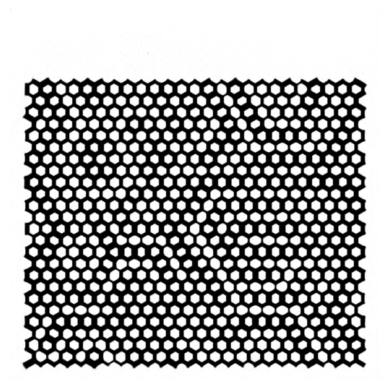

torch.Size([1, 8, 8])
tensor([ 63,  96,  56,  82,  48,  34,  21,  59, 114,  31,  21,  28, 105, 101,
         94,  81, 117,  92,  93,  36,  12,  57,  91,   9,  12,  75,  70,  97,
         96,  41,  78,  67,  92,  35,  70,  16,  40,  39,  33,  80,   5,  57,
         25, 103,  64,  50,  88,  76, 127, 114,  32,  36,  52,  97, 109,  30,
         40,  91,  76,  28,  62,  47,  40,  76])


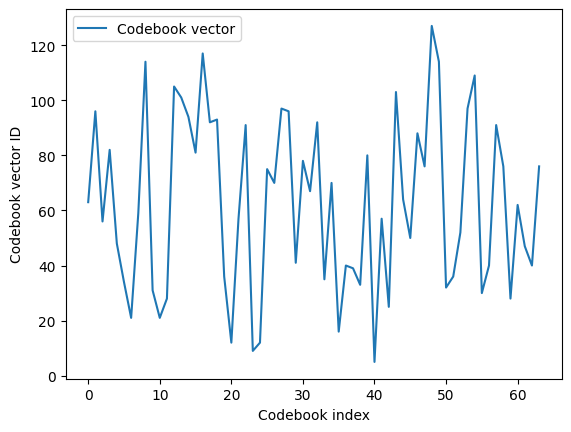

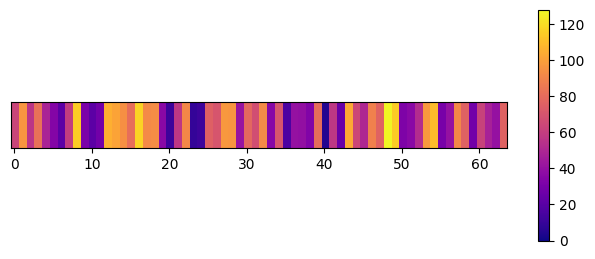

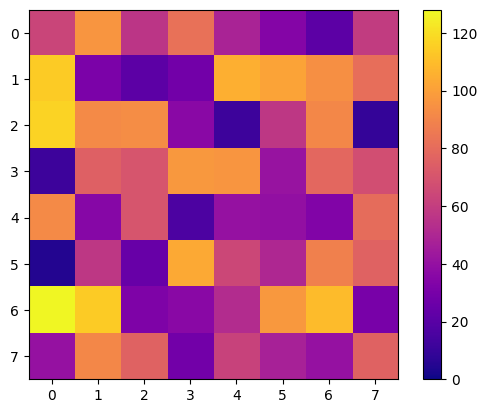

In [13]:
generate_from_indices (model, show_codes=True)

Fmap shape:  torch.Size([1, 16, 8, 8])


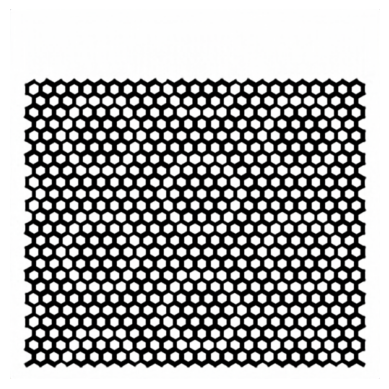

In [14]:
indices=torch.tensor([113,  20, 113,  20,  20, 113,  20,  47, 115,  97,  27,  97,  20,  36,
         97,  36,  27,  99,  47,  62, 115,  62, 113,  36,  97,  36,   2,  62,
         36, 113,  99,  36, 115,  26,  47,  62, 115,  97,  47,  97, 115, 115,
        115, 115,  62, 115,  36,  62,  62,  97,  43,   2, 121,  36, 121,  99,
         62,  47,  47,  99,  99,  62,  20,  99])
generate_from_indices (model,indices)

Fmap shape:  torch.Size([1, 16, 8, 8])


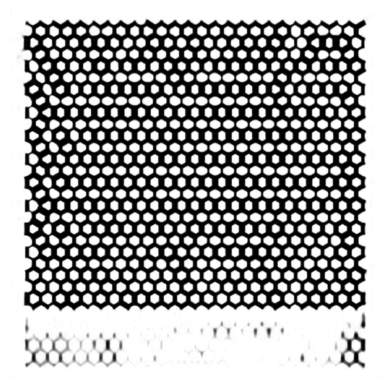

In [15]:
indices=torch.tensor([15]*64)
generate_from_indices (model,indices)

### Sample from dataloader 

In [16]:
def sample (model, test_loader, samples = 16, fname1 = None, fname2 = None, 
            batches=1, save_ind_files=False,flag=0,indices_hist=True,
           show_codes=False):
    model.eval()
    e=flag
    indices_list=[]
    batches=min (len (test_loader), batches)
    print ("Number of batches produced: ", batches)
    with torch.no_grad():

        for batch_idx, (x) in enumerate(tqdm(test_loader)):

            x = x.to(DEVICE)
            
            x_hat, indices, commitment_loss,    = model(x)

            with torch.no_grad():
                x_enc =model.encode(x)
             
            with torch.no_grad():
                z, indices=model.encode_z(x)
            
            with torch.no_grad():
                x_hat_snapped, z_quant =  model.decode_snapped(z,  )
    
            samples= min([samples, x.shape[0]])
             
            x_hat=unscale_image(x_hat)
           
            x=unscale_image(x)
            
            indices_list.append (indices.cpu().detach().flatten().numpy())

            if save_ind_files:
               
                for iu in range (samples):
                    fname2= prefix+ f"recon_samples_{e}_{batch_idx}_{iu}.png"
                    print ("Save individual samples ", fname2)

                    image_sample = to_pil(  x[iu,:].cpu()  )

                    image_sample.save(f'{fname2}', format="PNG",  subsampling=0  )
                    
                    fname2= prefix+ f"recon_samples_{e}_{batch_idx}_{iu}.png"
                    print ("Save individual samples ", fname2)

                    image_sample = to_pil( x_hat[iu,:].cpu()  )

                    image_sample.save(f'{fname2}', format="PNG",  subsampling=0  )
                    
                    plt.imshow (image_sample)
                    plt.axis('off')
                    plt.show()
                    if show_codes:
                        
                        plt.plot (indices[iu,:].cpu().detach().flatten().numpy(),label='Codebook vectors')
                        plt.legend()
                        plt.xlabel ('Codebook index')
                        plt.ylabel ('Codebook vector ID')
                        plt.show()
                        
                        indices_list.append (indices[iu,:].cpu().detach().flatten().numpy())
                        
                        plt.figure(figsize=(8, 3))
                        plt.imshow (indices[iu,:].cpu().detach().flatten().unsqueeze (0).numpy(), cmap='plasma',
                                   aspect=6.)
                        ax = plt.gca()
 
                        ax.get_yaxis().set_visible(False) 
                        plt.clim (0, num_codebook_vectors)
                        plt.colorbar()
                        plt.show()   
                        
                        plt.imshow (indices[iu,:].cpu().detach().numpy(), cmap='plasma',)
                        plt.clim (0, num_codebook_vectors)
                        plt.colorbar()
                        plt.show() 

            draw_sample_image(x[:samples], "Ground-truth images", fname1)
            draw_sample_image(x_hat[:samples], "Reconstructed images", fname2)

            if batch_idx>=(batches-1):
                
                if indices_hist:
                    indices_list=np.array (indices_list).flatten()
                    
                    n_bins =num_codebook_vectors 

                    # Creating histogram
                    fig, axs = plt.subplots(1, 1,
                                            figsize =(4, 3),
                                            tight_layout = True)

                    axs.hist(indices_list, bins = n_bins, density=True)
                    plt.xlabel("Codebook indices")
                    plt.ylabel("Frequency")
                   
                    plt.show()
                
                break

    return

Number of batches produced:  2


  0%|          | 0/13 [00:00<?, ?it/s]

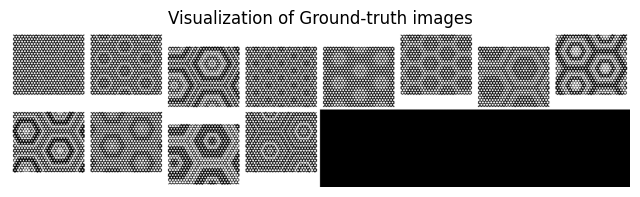

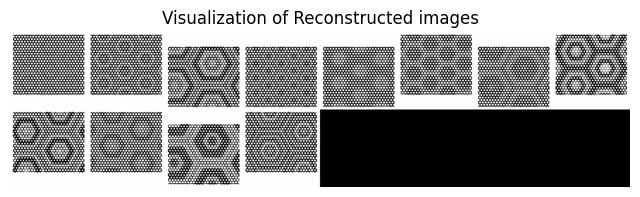

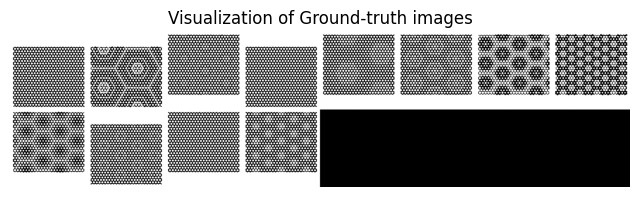

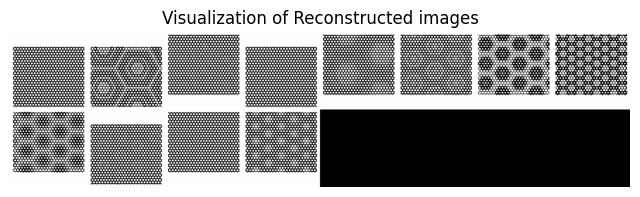

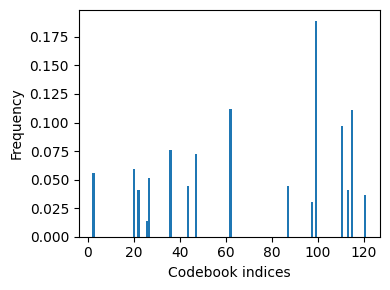

In [18]:
sample (model, test_loader, fname1 =f'{prefix}/or_test.png', fname2=f'{prefix}/rec_test.png',samples = 32,
       batches=2,save_ind_files=False,
       flag=10,
       show_codes=False,indices_hist=True,
       )

Number of batches produced:  32


  0%|          | 0/41 [00:00<?, ?it/s]

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


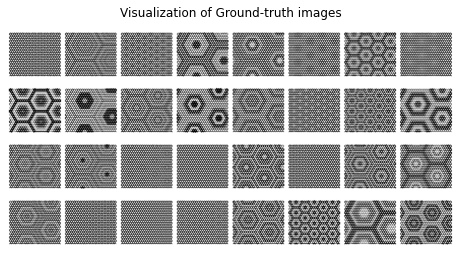

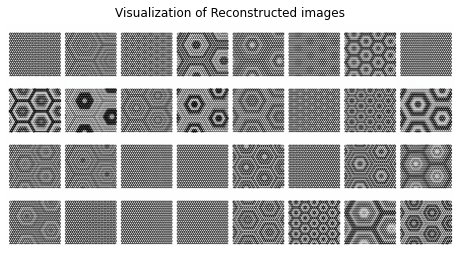

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


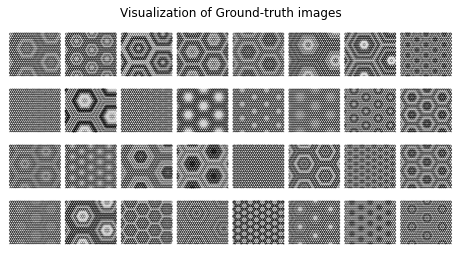

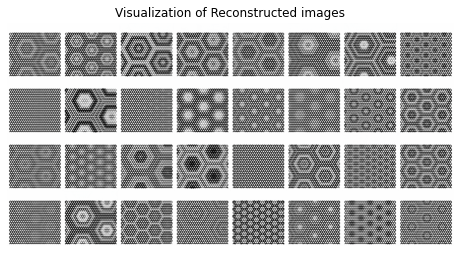

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


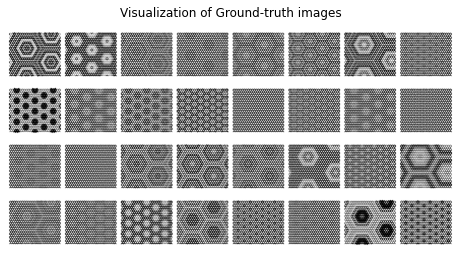

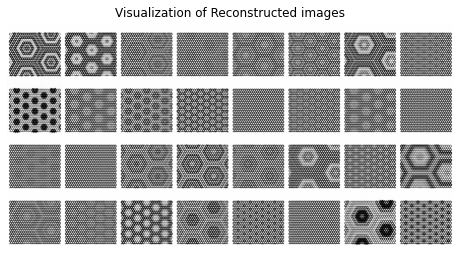

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


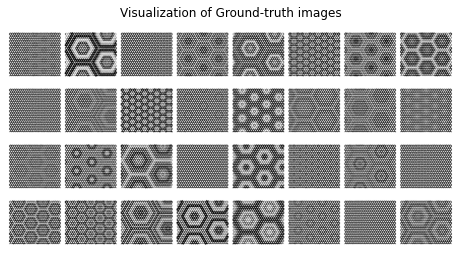

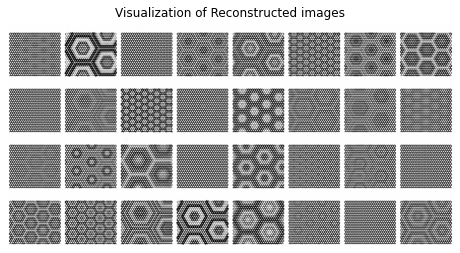

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


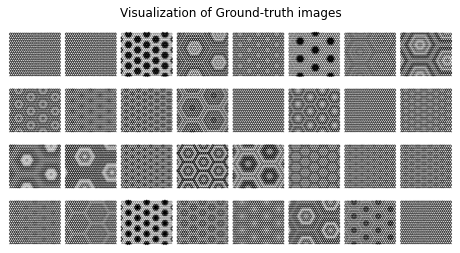

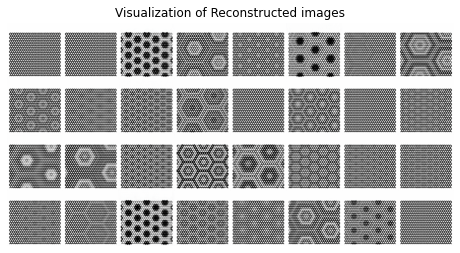

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


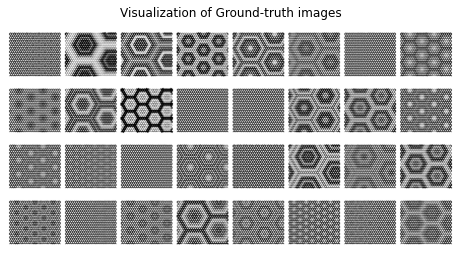

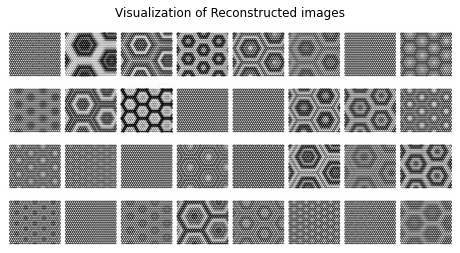

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


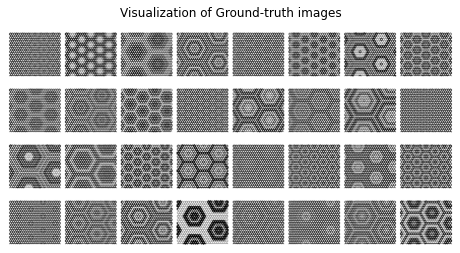

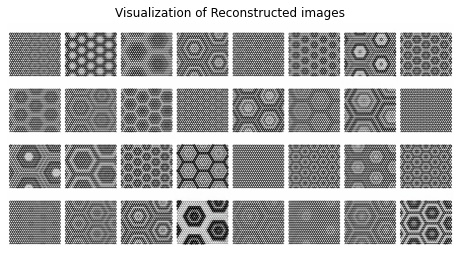

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


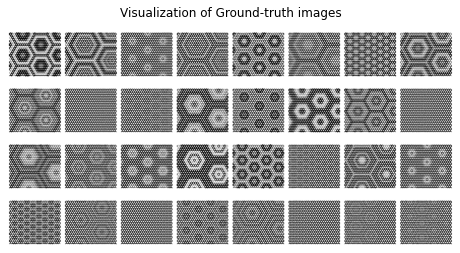

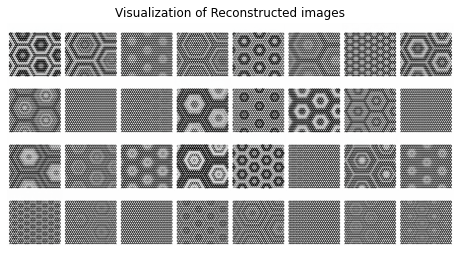

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


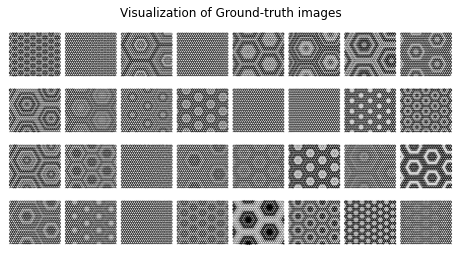

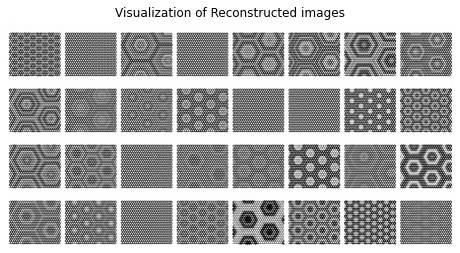

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


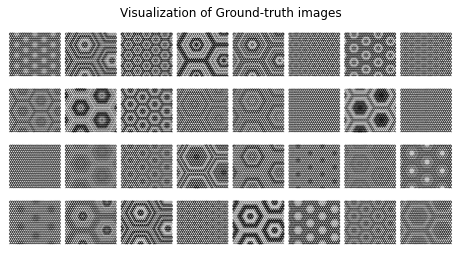

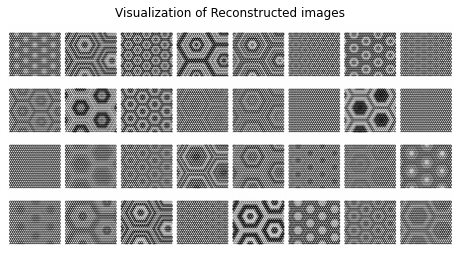

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


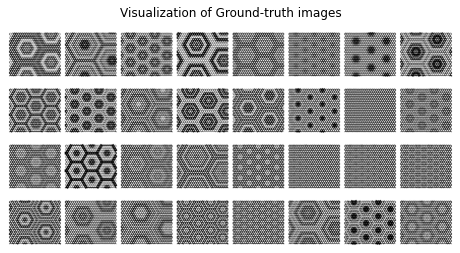

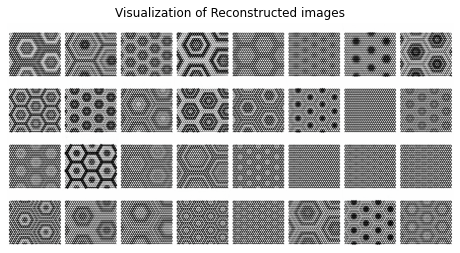

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


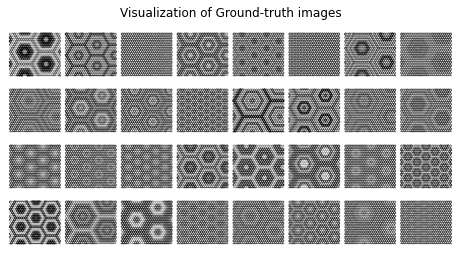

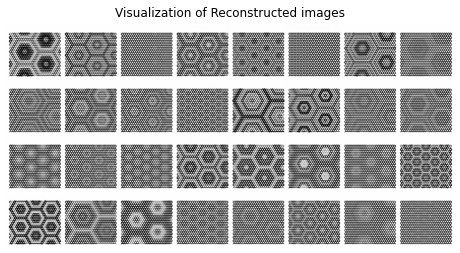

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


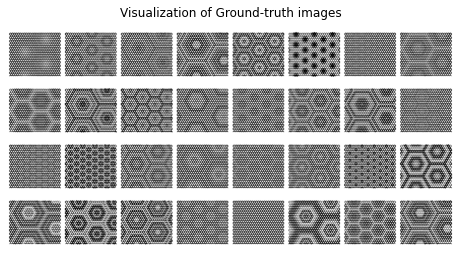

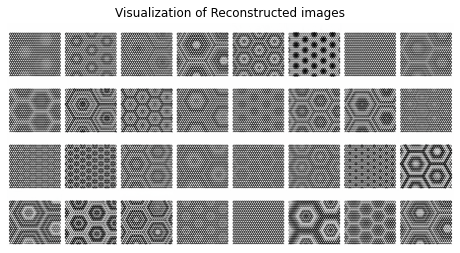

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


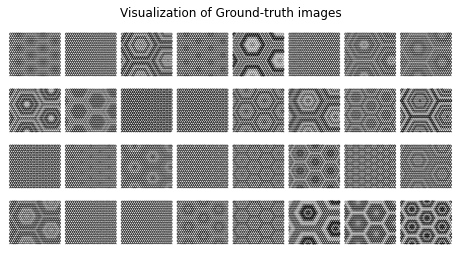

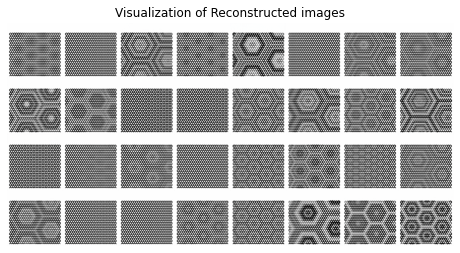

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


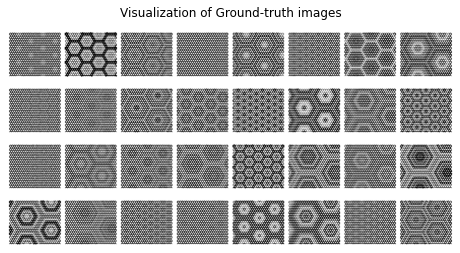

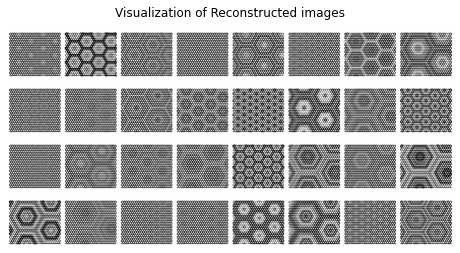

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


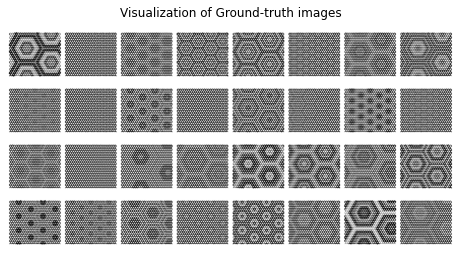

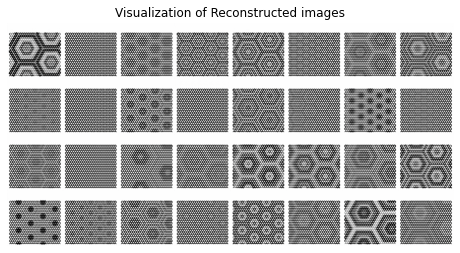

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


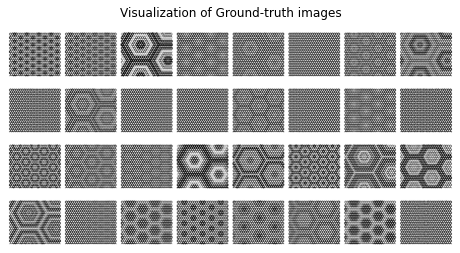

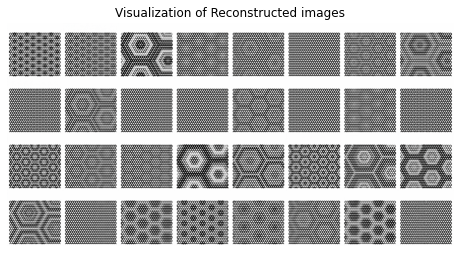

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


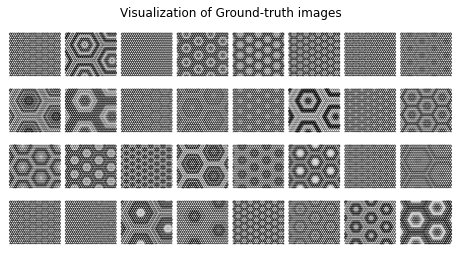

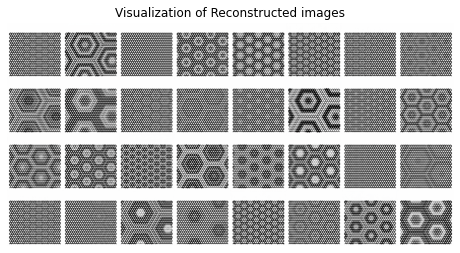

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


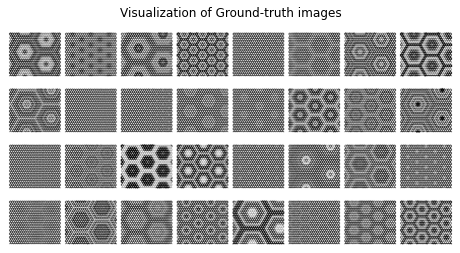

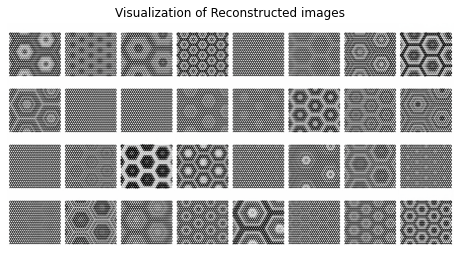

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


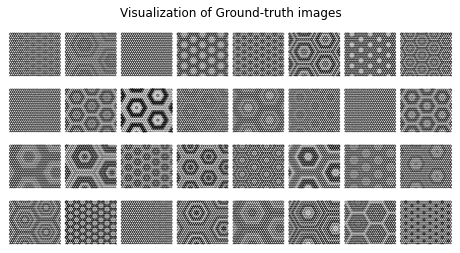

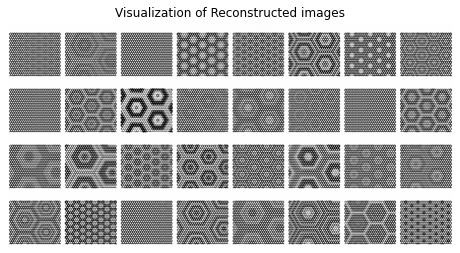

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


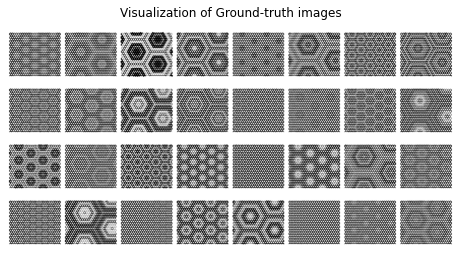

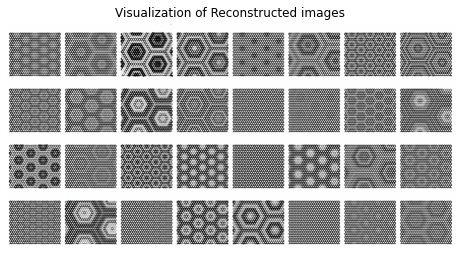

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


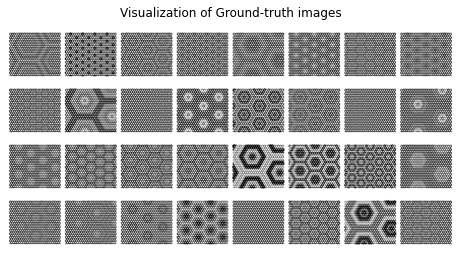

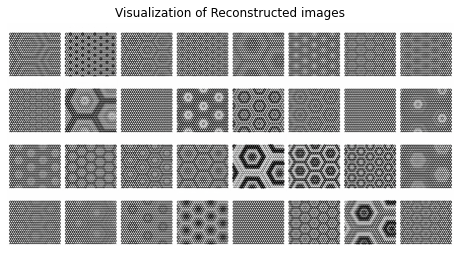

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


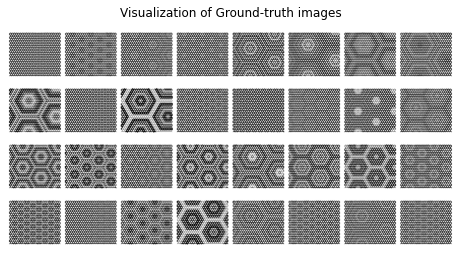

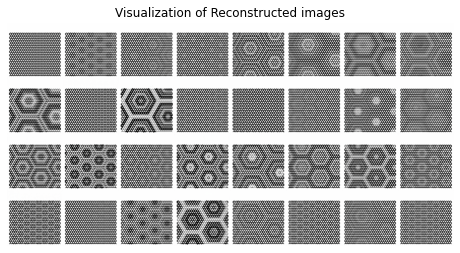

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


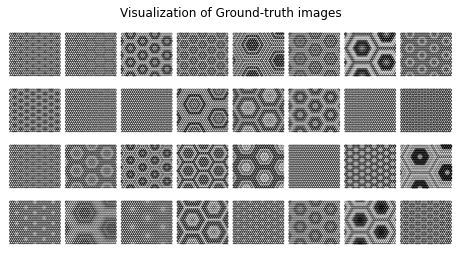

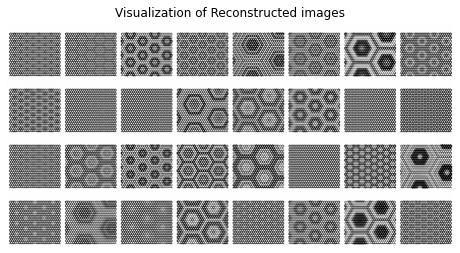

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


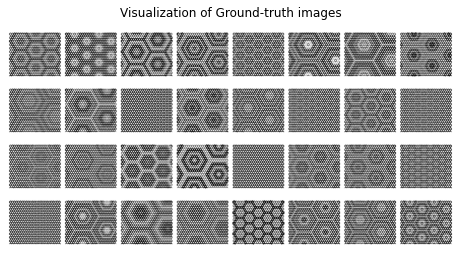

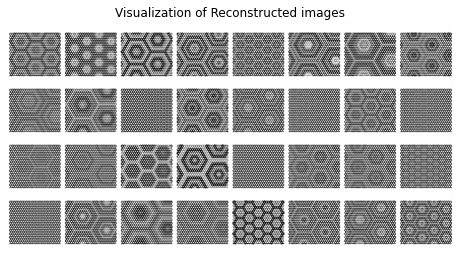

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


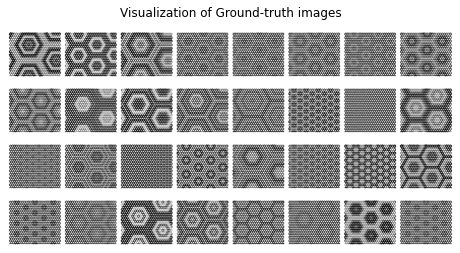

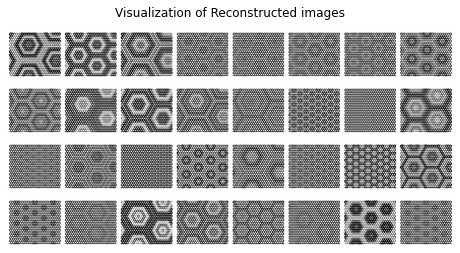

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


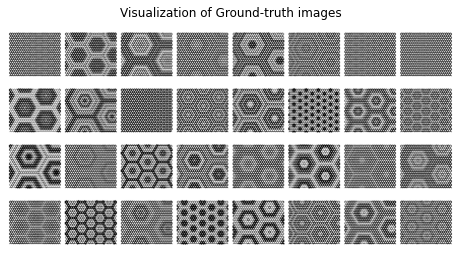

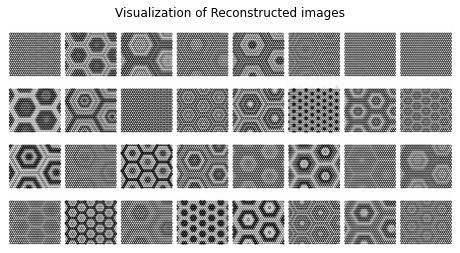

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


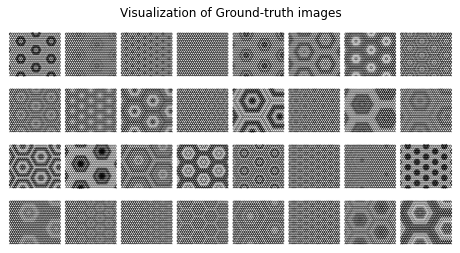

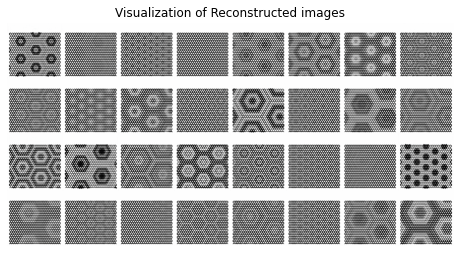

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


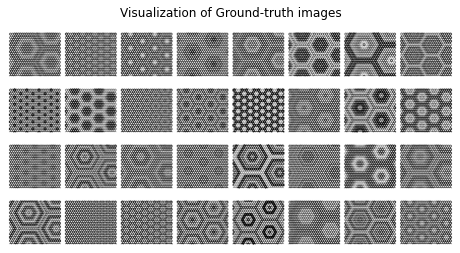

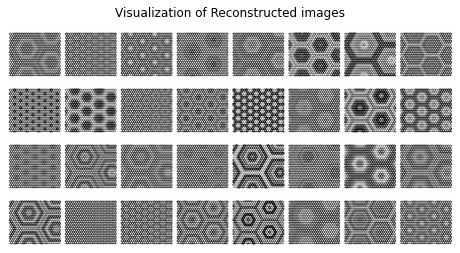

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


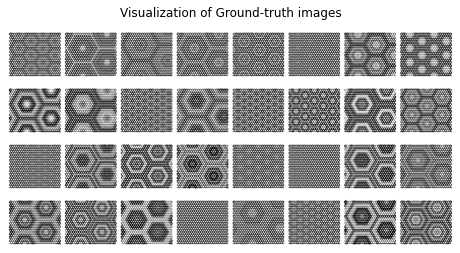

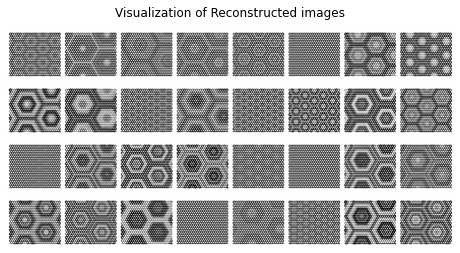

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


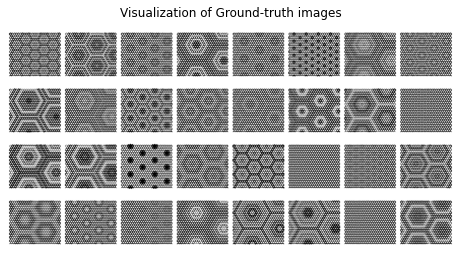

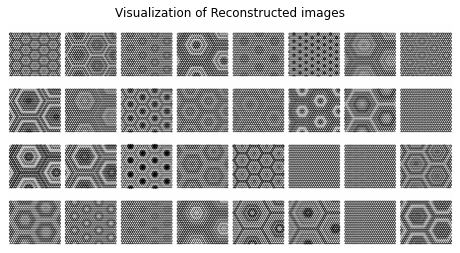

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


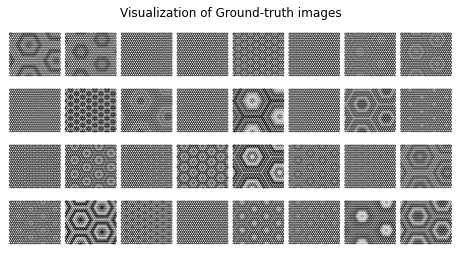

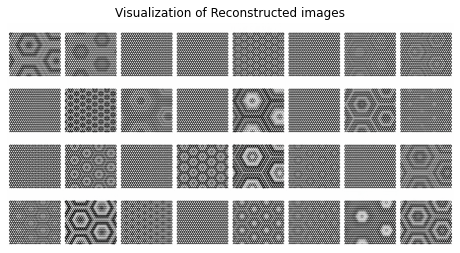

(65536,)
[113  43  20 ...  97  20  99]


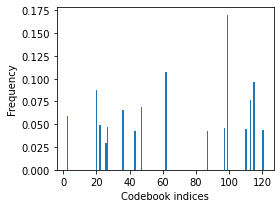

In [139]:
sample (model, train_loader, fname1 =f'{prefix}/or_test.png', fname2=f'{prefix}/rec_test.png',samples = 32,
       batches=32,save_ind_files=False,
       flag=10,
       show_codes=False,indices_hist=True,
       )

### Step 5: Training the model (if pretrained model is not loaded from checkpoint)

In [31]:
from torch.optim import Adam
from torch import nn

mse_loss = nn.MSELoss()
optimizer = Adam(model.parameters(), lr=lr)

In [42]:
isample=1 #sample frequency

loss_list=[]
step=0

epochs = 128

print_step = 1
icheckpt = 5

min_loss = 999999999

In [43]:
def train_steps (model, train_loader, test_loader, startep=0, epochs=500,min_loss = 999):
    print("Start training VQ-VAE...")

    startstep=len (train_loader)*startep
    step=startep
    for epoch in range(epochs):
        overall_loss = 0
        losscoll=0
        for batch_idx, (x) in enumerate(tqdm(train_loader)):
                x = x.to(DEVICE)
                model.train()
                optimizer.zero_grad()

                x_hat, indices, commitment_loss = model(x)
                recon_loss = mse_loss(x_hat, x)

                loss =  recon_loss + commitment_loss #+ codebook_loss

                loss.backward()
                optimizer.step()

                losscoll=losscoll+loss.item ()

        if step % print_step ==0: 
            print("epoch:", epoch + 1 + startep, "  step:", batch_idx + 1 +startstep, "  recon_loss:", recon_loss.item(), #"  perplexity: ", perplexity.item(), 
                  "\n\t\tcommit_loss: ", commitment_loss.item(), 
                  " total_loss: ", loss.item())

        loss_list.append (losscoll/len (train_loader))

        if step % isample == 0:

            fname1 = f'{prefix}/or_sample-epoch_{step+startstep}.png'
            fname2 = f'{prefix}/rec_sample-epoch_{step+startstep}.png'

            sample (model, test_loader, fname1=fname1, fname2=fname2, samples=16)
            plt.plot (loss_list)
            plt.xlabel ('Iterations')
            plt.ylabel ('Total loss')
            plt.show()

        if losscoll/len (train_loader)<min_loss:
            min_loss=losscoll/len (train_loader)
            print ("Smaller loss found")
            save=True

        if save or (step % icheckpt ==0):

            fname = f'{prefix}/model-epoch_{step}.pt'
            torch.save(model.state_dict(), fname)
            print ("Saved checkpoint: ", fname)

            save=False

        step=step+1

In [ ]:
 
if not  load_model:
    train_steps (model, train_loader, test_loader, startep=0, epochs=epochs)

In [ ]:
sample (model, test_loader, num_batches=4)

### Visualize and sample

  0%|          | 0/5 [00:00<?, ?it/s]

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


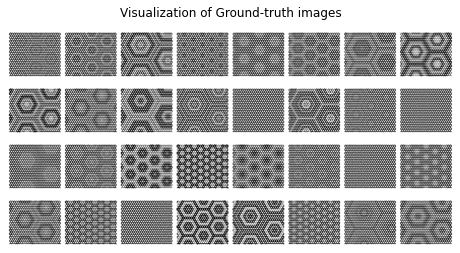

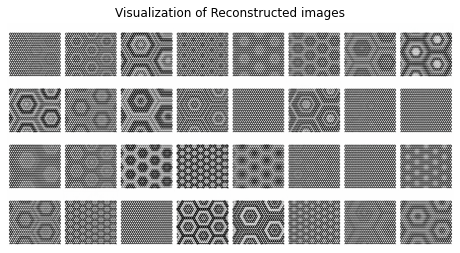

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


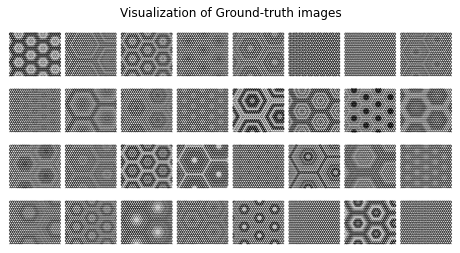

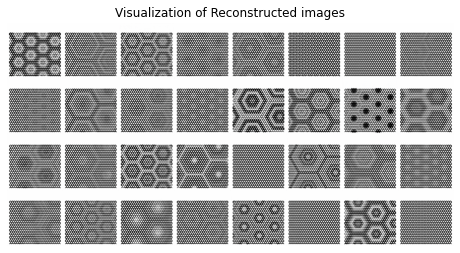

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


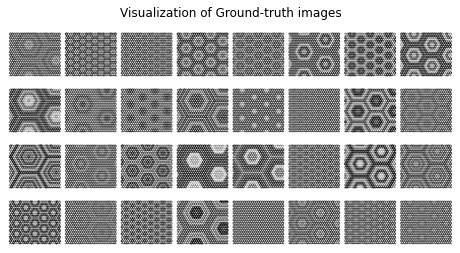

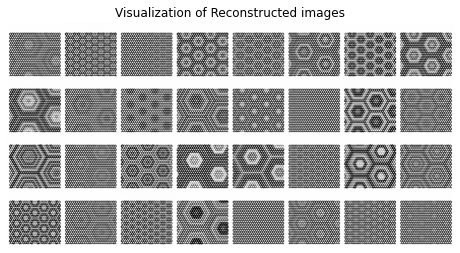

x shape  torch.Size([32, 3, 512, 512])
x encoded shape  torch.Size([32, 16, 8, 8])
codebook shape  torch.Size([32, 16, 8, 8])
0.0


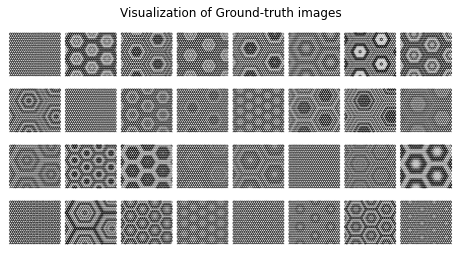

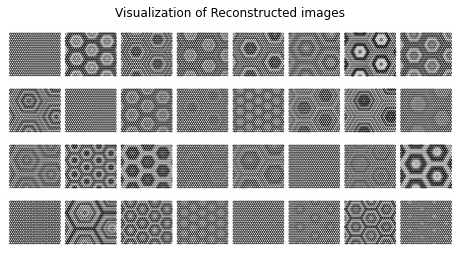

x shape  torch.Size([17, 3, 512, 512])
x encoded shape  torch.Size([17, 16, 8, 8])
codebook shape  torch.Size([17, 16, 8, 8])
0.0


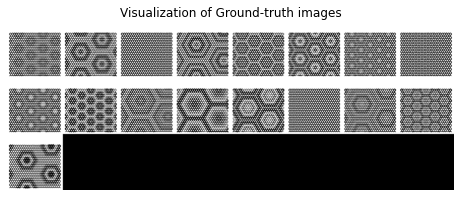

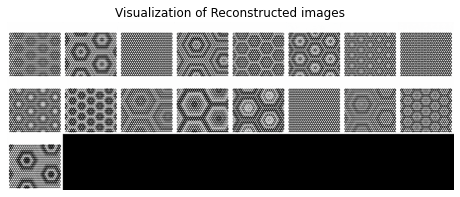

In [115]:
sample (model, test_loader, fname1 =f'{prefix}/or_test.png', fname2=f'{prefix}/rec_test.png',samples = 32,
       batches=4)